In [1]:
import numpy as np
import matplotlib.pyplot as pyp
from scipy.fftpack import dct,idct
from scipy.io import wavfile
import IPython
from scipy.signal import lfilter

In [20]:
def mdct_frame(x):
    N = x.shape[0]
    I = np.eye(N//4)
    J = np.fliplr(I)
    Z = np.zeros((N//4,N//4))
    Q = np.concatenate((np.concatenate((Z,Z,-J,-I),1),np.concatenate((I,-J,Z,Z),1)),0)
    
    Nw = 120
    vw = np.sin((np.pi/2)*(np.sin((np.pi/(2*Nw))*(np.arange(Nw) + 0.5)))**2)
    w = np.concatenate((np.zeros(420),vw,np.ones(840),np.flip(vw),np.zeros(420)))
#     w = np.ones(N)
    
    x = w*x
    mdct = dct(Q@x, type = 4, norm =None)*(2.0/N)
    
    return mdct

def imdct_frame(x):
    N = x.shape[0]*2
    I = np.eye(N//4)
    J = np.fliplr(I)
    Z = np.zeros((N//4,N//4))
    Q = np.concatenate((np.concatenate((Z,Z,-J,-I),1),np.concatenate((I,-J,Z,Z),1)),0)
    
    Nw = 120
    vw = np.sin((np.pi/2)*(np.sin((np.pi/(2*Nw))*(np.arange(Nw) + 0.5)))**2)
    w = np.concatenate((np.zeros(420),vw,np.ones(840),np.flip(vw),np.zeros(420)))
#     w = np.ones(N)

    imdct = Q.T@idct(x, type = 4, norm = None)*(0.5)
    
    return w*imdct

def mdct_ola(x,N,H):
    l = []
    xzp = np.concatenate((np.zeros(N//2),x,np.zeros(N//2)),0)
    for i in range(0,x.shape[0] + 1,H):
        l.append(mdct_frame(xzp[i:i+N]))
    
    return np.stack(l,0)

def imdct_ola(x,N,H,Nog):
    x_tilde = np.zeros(Nog + N)
    
    for i in range(x.shape[0]):
        x_tilde[i*H:i*H+N] = x_tilde[i*H:i*H+N] + imdct_frame(x[i,:])
    
    return x_tilde[N//2:Nog + N//2]
#     return x_tilde

# def mdct_opus_ola(x,N,H):
#     l = []
#     for i in range(0,x.shape[0] - N,H):
#         xzp = np.concatenate((np.zeros(420),x[i:i+N],np.zeros(420)))
#         l.append(mdct_frame(xzp))
        
#     return np.stack(l,0)


# # TODO (not completed)
# def imdct_opus_ola(x,N,H):
#     x_tilde = np.zeros(Nog)
    
#     for i in range(x.shape[0]):
#         x_padded = imdct_frame(x[i,:])
#         x_tilde[i*H:i*H+N] = x_tilde[i*H:i*H+N] + x_padded[420:420 + ]
    

def mdct2bands(mdct,band_defs):
    mdct_norm = np.copy(mdct)
    list_E = []

    for i in range(band_defs.shape[0] - 1):
        list_E.append(np.linalg.norm(mdct[:,band_defs[i]:band_defs[i+1]],axis = 1))
        mdct_norm[:,band_defs[i]:band_defs[i+1]] = mdct_norm[:,band_defs[i]:band_defs[i+1]]/list_E[-1][:,None]
    
    list_E = np.stack(list_E,axis = 1)
    
    return list_E,mdct_norm

def mdctbands2mdct(mdct_bands,list_E,band_defs):
    mdct_bands_unnormalized = np.copy(mdct_bands)

    for i in range(band_defs.shape[0] - 1):
#         randV = np.random.randn(mdct_bands.shape[0],band_defs[i+1] - band_defs[i])
#         randV = randV/np.linalg.norm(randV,axis = 1)[:,None]
#         mdct_bands[:,band_defs[i]:band_defs[i+1]] = randV*list_E[:,i][:,None]
        mdct_bands[:,band_defs[i]:band_defs[i+1]] = mdct_bands[:,band_defs[i]:band_defs[i+1]]*list_E[:,i][:,None]
    
    # Simulating Packet Loss
    # percent_loss = 0.5
    # random_indices = np.random.choice(mdct_bands.shape[0], size=(int)(percent_loss*mdct_bands.shape[0]), replace=False)
    # for i in range(band_defs.shape[0] - 1):
    #     randV = np.random.randn(random_indices.shape[0],band_defs[i+1] - band_defs[i])
    #     randV = randV/np.linalg.norm(randV,axis = 1)[:,None]
    #     mdct_bands[random_indices,band_defs[i]:band_defs[i+1]] = randV*list_E[random_indices,i][:,None]
#         randE = (np.random.randn(random_indices.shape[0],1))**2
#         mdct_bands[random_indices,band_defs[i]:band_defs[i+1]] = mdct_bands[random_indices,band_defs[i]:band_defs[i+1]]*randE
        
    return mdct_bands

In [3]:
# sr,x = wavfile.read('/Users/krisub/Desktop/Stuff/comp_mono48.wav')
# x = x/ 32768.0
# x = x[:10*sr]
N = 960*2
H = 480*2
band_defs = np.array([0,  1,  2,  3,  4,  5,  6,  7,  8, 10, 12, 14, 16, 20, 24, 28, 34, 40, 48, 60, 78, 100])*8
ebandMeans = np.array([
      6.437500, 6.250000, 5.750000, 5.312500, 5.062500,
      4.812500, 4.500000, 4.375000, 4.875000, 4.687500,
      4.562500, 4.437500, 4.875000, 4.625000, 4.312500,
      4.500000, 4.375000, 4.625000, 4.750000, 4.437500,
      3.750000, 3.750000, 3.750000, 3.750000, 3.750000
])

In [47]:
# DC Rejection and Pre-emphasis
c = (6.3*3/48000)
x = lfilter([1,-1],[1,-(1-c)],x) # DC Reject
x = lfilter([1,-0.85],[1],x) # Pre-emphasis

In [48]:
# MDCTs from opus_demo.c
numbers = np.genfromtxt('/Users/krisub/Downloads/opus-master/CELT_mdcts.txt',delimiter=',') 
numbers = numbers[:,:-1]

In [64]:
mdct_x = mdct_ola(x[420:]*32768,N,H) #420 shift is to account for 420 zeros to append to first frame for 2N MDCT method

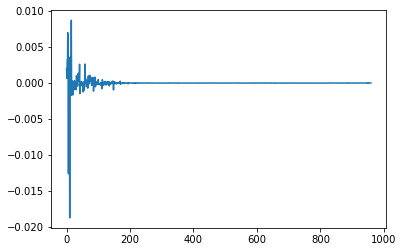

In [22]:
pyp.plot(mdct_x[5] - numbers[5])
# pyp.plot(numbers[5])

In [13]:
imdct_x_recon_opus = imdct_ola(numbers,N,H,x.shape[0])
imdct_x_recon_python = imdct_ola(mdct_x,N,H,x.shape[0])

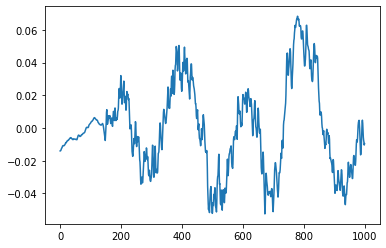

In [14]:
pyp.plot(imdct_x_recon_opus[:1000] - imdct_x_recon_python[:1000])
# pyp.plot(imdct_x_recon_python[:1000])

In [15]:
IPython.display.display(IPython.display.Audio(data = imdct_x_recon_opus,rate = sr))
IPython.display.display(IPython.display.Audio(data = imdct_x_recon_python,rate = sr))

In [135]:
# Obtain Training Data
tD,mdct_normalized = mdct2bands(mdct_x,band_defs)
log_tD = np.log2(tD) - ebandMeans[:21]

# Band Energies from opus demo
bandLogE = np.genfromtxt('/Users/krisub/Downloads/opus-master/CELT_mdcts_bandlogE.txt',delimiter=',') 
bandLogE = bandLogE[:,:-1]

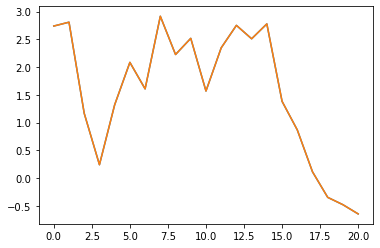

In [136]:
# pyp.plot(tD[3] - bandE[3])
pyp.plot(bandLogE[2])
pyp.plot(log_tD[2])

In [96]:
# Dumping the data into a numpy array
np.save("./feature_dump.npy",log_tD)

In [119]:
loss_trace = np.fromfile("/Users/krisub/Desktop/Datasets/train_loss.u8",dtype = np.uint8)

In [143]:
# "Invert" band Energies to obtain audio
# Invert Log
band_E_recon = 2**(bandLogE + ebandMeans[:21])
mdct_recon_x = mdctbands2mdct(mdct_normalized,band_E_recon,band_defs)

recon_x = imdct_ola(mdct_recon_x,N,H,x.shape[0])


In [44]:
ble = np.genfromtxt('../tts_speech_negative_48k_bandLogE',delimiter=',') 
ble = ble[:,:21]
mdct = np.genfromtxt('../tts_speech_negative_48k_mdctnormalized',delimiter=',') 
mdct = mdct[:,:960]
mdct[:,800:] = 0

In [61]:
bandE_nonlog = 2**(ble + ebandMeans[:21])
mdct_recon_x = mdctbands2mdct(mdct,bandE_nonlog,band_defs)
recon_x = imdct_ola(mdct_recon_x,N,H,ble.shape[0]*960)

In [59]:
# Inverting DC Rejection and Pre-emphasis
recon_x = recon_x/32768
c = (6.3*3/48000)
recon_x = lfilter([1,-(1-c)],[1,-1],recon_x) # DC Reject
recon_x = lfilter([1],[1,-0.85],recon_x) # Pre-emphasis

In [60]:
IPython.display.display(IPython.display.Audio(data = recon_x,rate = 48000))

In [43]:
ble[0]

array([ 1.217818,  2.491094,  0.955327,  0.24361 , -0.140417,  0.946066,
        0.124392,  1.995845,  2.014036,  1.847953,  0.448906,  1.37094 ,
        2.547915,  2.229154,  2.872061,  2.582778,  3.323952,  2.46558 ,
        2.817704,  2.694963,  2.697925])

In [41]:
np.linalg.norm(mdct[5][800:])

nan

In [154]:
x = np.fromfile("/Users/krisub/Desktop/Datasets/comp_mono48.raw",dtype = np.short)

In [30]:
a = np.array([1,2,3])

In [34]:
np.flip(a,0)

array([3, 2, 1])

In [65]:
loss_trace = np.memmap("../../datasets/train_loss.u8",dtype = np.uint8,mode = 'r')

In [67]:
loss_trace

memmap([1, 1, 1, ..., 1, 1, 1], dtype=uint8)

In [79]:
features = np.memmap("../tts_speech_negative_48k_bandLogE", dtype='float32', mode='r')

In [85]:
features.shape[0]//21

4540

In [71]:
ble

memmap([45, 57, 46, ..., 51, 44, 10], dtype=uint8)